
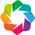

In [1]:
import numpy as np
import holoviews as hv
import datashader as ds
from holoviews.operation.datashader import aggregate, shade, datashade, dynspread
from holoviews.operation import decimate
hv.extension('bokeh')
decimate.max_samples=1000
dynspread.max_px=20
dynspread.threshold=0.5

def random_walk(n, f=5000):
    """Random walk in a 2D space, smoothed with a filter of length f"""
    xs = np.convolve(np.random.normal(0, 0.1, size=n), np.ones(f)/f).cumsum()
    ys = np.convolve(np.random.normal(0, 0.1, size=n), np.ones(f)/f).cumsum()
    xs += 0.1*np.sin(0.1*np.array(range(n-1+f))) # add wobble on x axis
    xs += np.random.normal(0, 0.005, size=n-1+f) # add measurement noise
    ys += np.random.normal(0, 0.005, size=n-1+f)
    return np.column_stack([xs, ys])

def random_cov():
    """Random covariance for use in generating 2D Gaussian distributions"""
    A = np.random.randn(2,2)
    return np.dot(A, A.T)

def time_series(T = 1, N = 100, mu = 0.1, sigma = 0.1, S0 = 20):  
    """Parameterized noisy time series"""
    dt = float(T)/N
    t = np.linspace(0, T, N)
    W = np.random.standard_normal(size = N) 
    W = np.cumsum(W)*np.sqrt(dt) # standard brownian motion
    X = (mu-0.5*sigma**2)*t + sigma*W 
    S = S0*np.exp(X) # geometric brownian motion
    return S

In [2]:
np.random.seed(1)
points = hv.Points(np.random.multivariate_normal((0,0), [[0.1, 0.1], [0.1, 1.0]], (1000,)),label="Points")
paths = hv.Path([random_walk(2000,30)], label="Paths")

points + paths

:Layout
   .Points.Points :Points   [x,y]
   .Path.Paths    :Path   [x,y]

In [3]:
np.random.seed(1)
points = hv.Points(np.random.multivariate_normal((0,0), [[0.1, 0.1], [0.1, 1.0]], (1000000,)),label="Points")
paths = hv.Path([0.15*random_walk(100000) for i in range(10)],label="Paths")

In [4]:
points + paths

:Layout
   .Points.Points :Points   [x,y]
   .Path.Paths    :Path   [x,y]

In [13]:
from numpy.random import randn
import pandas as pd
import numpy as np

CYCLE=10
N_PAR_CYCLE=1000
n=CYCLE*N_PAR_CYCLE

df=pd.DataFrame(
    {
        "idx":np.arange(1, n+1),
        "step":np.tile(np.repeat(np.arange(1, 11), 100), CYCLE),
        "cycle_no":np.repeat(range(1, CYCLE+1), N_PAR_CYCLE),
        "cycle_cnt":np.tile(np.arange(1, N_PAR_CYCLE+1), CYCLE),
        "val": randn(n)+ np.repeat(range(CYCLE), N_PAR_CYCLE)
    }
)



In [23]:
hist = df.to(hv.Histogram, "val")

ValueError: Histogram vdims must be between length 1 and 1.

In [18]:
df=hv.Dataset(df)
df

:Dataset   [cycle_cnt,cycle_no,idx,step,val]

In [22]:
line = df.to(hv.Curve, 'cycle_cnt', ['val'], groupby='cycle_no').overlay()

In [23]:
line

:NdOverlay   [cycle_no]
   :Curve   [cycle_cnt]   (val)

In [27]:
np.unique(df["step"])


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])

gridspace = hv.GridSpace(kdims=['step'], group='Parameters', label='Sines')

steps = np.unique(df["step"])
cycle_cnts = np.unique(df["cycle_cnt"])

for step in steps:
    sub_df = df[df["step"] == step]
    overlay = sub_df.to(hv.Curve, 'cycle_cnt', ['val'], groupby='cycle_no').overlay()
    gridspace[step] = overlay


In [36]:
gridspace

:GridSpace   [step]
   :NdOverlay   [cycle_no]
      :Curve   [cycle_cnt]   (val)

In [32]:
df[df["step"] == step]

:Dataset   [cycle_cnt,cycle_no,idx,step,val]